In [1]:
import zarr
import xarray as xr
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
from global_land_mask import globe
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib as mpl
import scipy

from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from IPython.display import Image
from matplotlib.colors import ListedColormap

mpl.rcParams['figure.dpi']= 300
plt.rcParams.update({'font.size': 8})
mpl.rcParams['axes.linewidth'] = 0.3
g = 9.80616 #Avg. gravity acceleration on Earth

# New custom colormap
magma_cmap = plt.cm.magma_r
magma_cmap.set_under('white')

In [59]:
#ds = xr.open_dataset('/Users/rm65238/Documents/MATLAB/Gulf_2025_output.nc', chunks='auto')
#data = xr.open_dataset('/Users/rm65238/Documents/MATLAB/IVT_2025_Gulf.nc', chunks='auto')

In [67]:
ds = xr.open_dataset('/Users/rm65238/Documents/MATLAB/Texasrain_2025_output.nc')
data = xr.open_dataset('/Users/rm65238/Documents/MATLAB/IVT_2025_texas_rain.nc')

In [8]:
# Gulf
lat1, lat2 = 45, 10
lon1, lon2 = 250, 300

In [69]:
ds_sel = ds.sel(lat=slice(lat1,lat2), lon=slice(lon1,lon2))
data_sel = data.sel(latitude=slice(lat1,lat2), longitude=slice(lon1,lon2))

In [70]:
var = ds_sel.shapemap.fillna(0).squeeze()
IVT = np.sqrt(data_sel.ivtx**2 + data_sel.ivty**2)

In [71]:
check = ds.axismap
print(np.unique(check.values))

[nan]


In [52]:
vmax = IVT.max()

In [53]:
vmax.values

array(1905.24737024)

In [55]:
#var=var.isel(time=range(5))

/opt/miniconda3/envs/era5env/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1600: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contour(*args, **kwargs)
/opt/miniconda3/envs/era5env/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1600: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contour(*args, **kwargs)
/opt/miniconda3/envs/era5env/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1600: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contour(*args, **kwargs)
/opt/miniconda3/envs/era5env/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1600: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contour(*args, **kwargs)
/opt/miniconda3/envs/era5env/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1600: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = sup

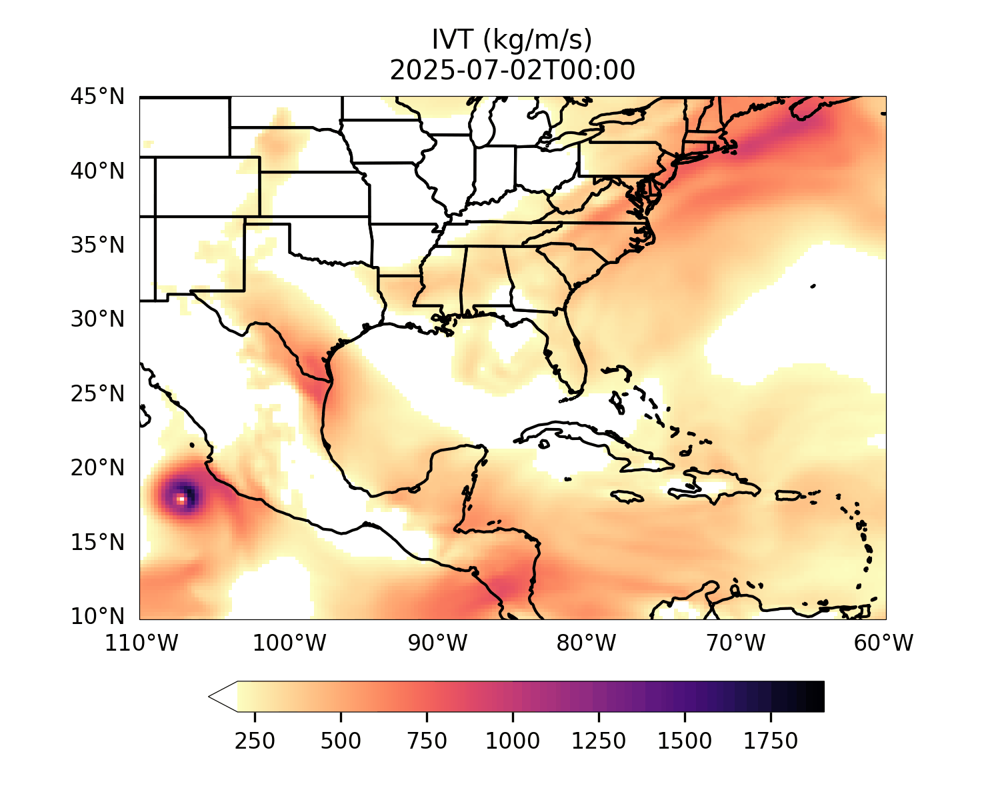

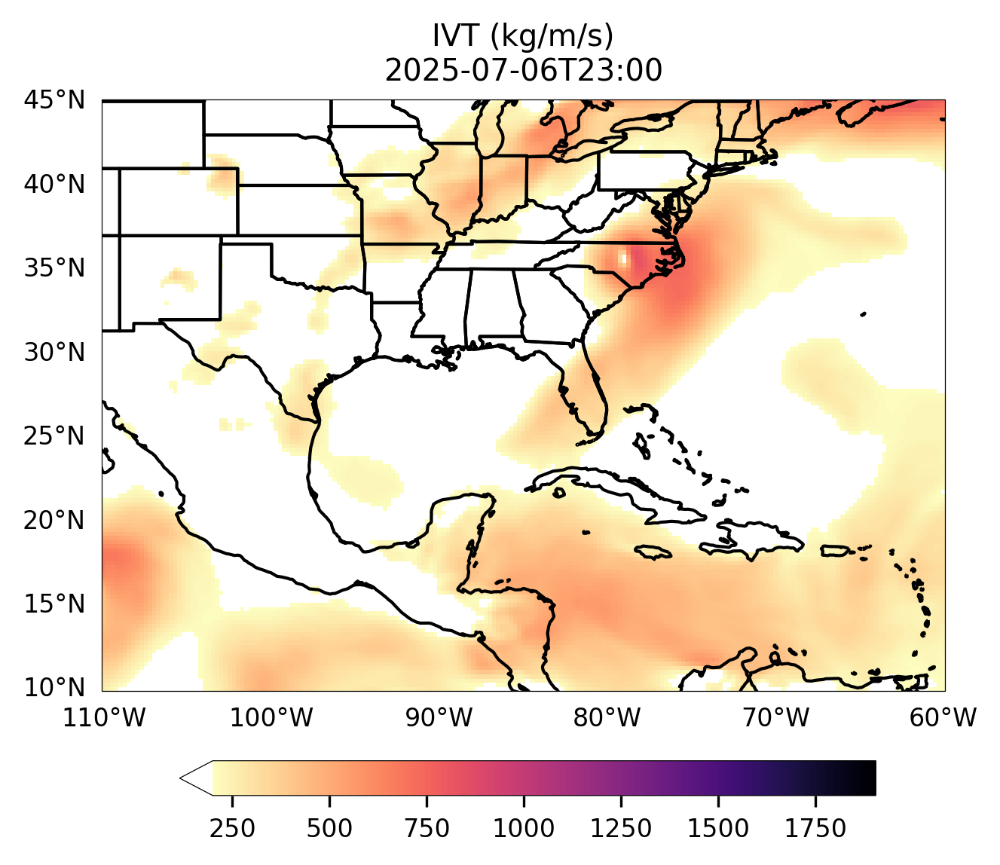

In [66]:
# Setup plot
fig, ax = plt.subplots(figsize=(5, 4), subplot_kw={'projection': ccrs.PlateCarree()})
ax.coastlines()
ax.add_feature(cfeature.STATES, edgecolor='black', zorder=10)

gls = ax.gridlines(draw_labels=True, color='none')
gls.top_labels = False
gls.right_labels = False



# Initial frame

current_plot = [ax.contour(var.lon, var.lat, var.isel(time=0),
    transform=ccrs.PlateCarree(),
    colors='lime',
    linewidths=0.4,
    add_colorbar=False
)]

cb = IVT.isel(time=0).plot(ax=ax, cmap=magma_cmap, add_colorbar=True, 
cbar_kwargs={'fraction': 0.05, 'orientation': 'horizontal', 'pad': 0.1}, 
vmin=200, vmax=vmax)

# Title
title = ax.set_title(f"IVT (kg/m/s)\n{str(var.time.values[0])[:16]}")

# Update function
def update(frame):
    current_plot[0].remove()

    # Plot new frame
    current_plot[0] = ax.contour(var.lon, var.lat, var.isel(time=frame).squeeze(),
        transform=ccrs.PlateCarree(),
        colors='lime',
        linewidths=0.4,
        add_colorbar=False
    )
    IVT.isel(time=frame).plot(ax=ax, cmap=magma_cmap, add_colorbar=False,
    vmin=200, vmax=vmax)
    
    title.set_text(f"IVT (kg/m/s)\n{str(var.time.values[frame])[:16]}")

    return current_plot[0], title

# Create animation
anim = FuncAnimation(fig, update, frames=len(var.time), interval=500, blit=True)
anim.save("IVT_animation.gif", writer="pillow", fps=2)

Image(filename="IVT_animation.gif")

In [48]:
variable2 = variable.sel(time=slice('2025-02-15T09:00:00.000000000', '2025-02-17T23:00:00.000003352'))

In [52]:
variable2

<xarray.DataArray 'shapemap' (ens: 1, time: 63, lev: 1, lat: 141, lon: 201)> Size: 7MB
[1785483 values with dtype=float32]
Coordinates:
  * lon      (lon) float64 2kB 250.0 250.2 250.5 250.8 ... 299.5 299.8 300.0
  * lat      (lat) float64 1kB 45.0 44.75 44.5 44.25 ... 10.75 10.5 10.25 10.0
  * lev      (lev) float64 8B 0.0
  * time     (time) datetime64[ns] 504B 2025-02-15T09:00:00 ... 2025-02-17T23...
  * ens      (ens) float64 8B 1.0
Attributes:
    long_name:  Shape
    units:      none

In [56]:
variable2.isel(time=0).squeeze()

<xarray.DataArray 'shapemap' (lat: 141, lon: 201)> Size: 113kB
[28341 values with dtype=float32]
Coordinates:
  * lon      (lon) float64 2kB 250.0 250.2 250.5 250.8 ... 299.5 299.8 300.0
  * lat      (lat) float64 1kB 45.0 44.75 44.5 44.25 ... 10.75 10.5 10.25 10.0
    lev      float64 8B 0.0
    time     datetime64[ns] 8B 2025-02-15T09:00:00
    ens      float64 8B 1.0
Attributes:
    long_name:  Shape
    units:      none

/opt/miniconda3/envs/era5env/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1600: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contour(*args, **kwargs)


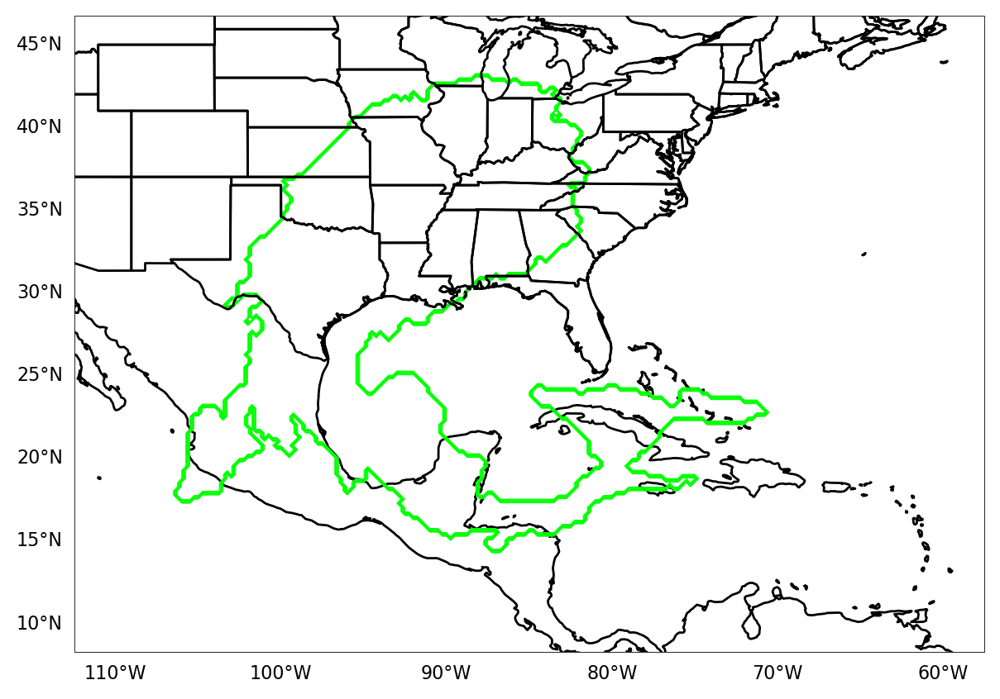

In [88]:
# Setup plot
fig, ax = plt.subplots(figsize=(10, 5), subplot_kw={'projection': ccrs.PlateCarree()})
ax.coastlines()
ax.add_feature(cfeature.STATES, edgecolor='black', zorder=10)

gls = ax.gridlines(draw_labels=True, color='none')
gls.top_labels = False
gls.right_labels = False

mask = variable2.isel(time=2).squeeze()
mask_filled = mask.fillna(0)
# Initial frame
current_plot = [ax.contour(mask.lon, mask.lat, mask_filled, 
    transform=ccrs.PlateCarree(),
    colors='lime',
    linewidths=0.4,
    add_colorbar=False,
)]

In [89]:
check = mask_filled
print(np.unique(check.values))

[0. 1.]


# Composite means calculations

In [2]:
# Texas ARs
lat_sel= 33
lon_sel= -105

# Kansas ARs
lat_sel= 39
lon_sel= -94

In [3]:
# US whole
lat1, lat2 = 50, 20
lon1, lon2 = 235, 295

In [4]:
pik_filtered = np.array([], dtype='datetime64[ns]')
for k in range(0,24):
    if k<10:
        pik = xr.open_dataset('/Users/rm65238/Documents/PIKART/PIKARTV1_lagrangian_ERA5_0p5deg_6hr_200'+str(k)+'.nc')
    else:
        pik = xr.open_dataset('/Users/rm65238/Documents/PIKART/PIKARTV1_lagrangian_ERA5_0p5deg_6hr_20'+str(k)+'.nc')
    pik_sel = pik.footprints.sel(latitude=lat_sel, longitude=lon_sel, method='nearest') # select all ARs over a particular point
    t = pik_sel.where(pik_sel!=0, drop=True)
    pik_filtered = np.append(pik_filtered, t.time.values) # drop all timesteps that without an AR over the point
    print(pik_filtered.size)

98
171
260
337
418
469
509
591
740
815
923
1000
1098
1153
1243
1329
1392
1494
1573
1647
1691
1782
1863
1938


In [5]:
ds = xr.open_zarr(
    'gs://gcp-public-data-arco-era5/ar/full_37-1h-0p25deg-chunk-1.zarr-v3',
    consolidated=True,
    storage_options={'token': 'anon'}
)

In [7]:
# Climatology ERA5 dataset
clim = xr.open_zarr('gs://weatherbench2/datasets/era5-hourly-climatology/1990-2019_6h_1440x721.zarr')

In [9]:
# older code
'''
soilm_clim = clim.volumetric_soil_water_layer_1.sel(latitude=slice(lat1,lat2), longitude=slice(lon1,lon2)).mean(dim=['hour', 'dayofyear']).squeeze()
ps_clim = clim.surface_pressure.sel(latitude=slice(lat1,lat2), longitude=slice(lon1,lon2)).mean(dim=['hour', 'dayofyear']).squeeze()/100
mtpr_clim = 1000*clim.total_precipitation_6hr.sel(latitude=slice(lat1,lat2), longitude=slice(lon1,lon2)).mean(dim=['hour', 'dayofyear'])/6
'''

"\nsoilm_clim = clim.volumetric_soil_water_layer_1.sel(latitude=slice(lat1,lat2), longitude=slice(lon1,lon2)).mean(dim=['hour', 'dayofyear']).squeeze()\nps_clim = clim.surface_pressure.sel(latitude=slice(lat1,lat2), longitude=slice(lon1,lon2)).mean(dim=['hour', 'dayofyear']).squeeze()/100\nmtpr_clim = 1000*clim.total_precipitation_6hr.sel(latitude=slice(lat1,lat2), longitude=slice(lon1,lon2)).mean(dim=['hour', 'dayofyear'])/6\n"

In [8]:
clim

<xarray.Dataset> Size: 1TB
Dimensions:                                         (hour: 4, dayofyear: 366,
                                                     latitude: 721,
                                                     longitude: 1440, level: 13)
Coordinates:
  * dayofyear                                       (dayofyear) int64 3kB 1 ....
  * hour                                            (hour) int64 32B 0 6 12 18
  * latitude                                        (latitude) float32 3kB 90...
  * level                                           (level) int64 104B 50 ......
  * longitude                                       (longitude) float32 6kB 0...
Data variables: (12/53)
    10m_u_component_of_wind                         (hour, dayofyear, latitude, longitude) float32 6GB dask.array<chunksize=(3, 3, 721, 1440), meta=np.ndarray>
    10m_v_component_of_wind                         (hour, dayofyear, latitude, longitude) float32 6GB dask.array<chunksize=(3, 3, 721, 1440), meta=np.ndarray>
    10m_wind_speed                                  (hour, dayofyear, latitude, longitude) float32 6GB dask.array<chunksize=(3, 3, 721, 1440), meta=np.ndarray>
    2m_dewpoint_temperature                         (hour, dayofyear, latitude, longitude) float32 6GB dask.array<chunksize=(3, 3, 721, 1440), meta=np.ndarray>
    2m_temperature                                  (hour, dayofyear, latitude, longitude) float32 6GB dask.array<chunksize=(3, 3, 721, 1440), meta=np.ndarray>
    above_ground                                    (hour, dayofyear, level, latitude, longitude) float32 79GB dask.array<chunksize=(3, 3, 1, 721, 1440), meta=np.ndarray>
    ...                                              ...
    volumetric_soil_water_layer_1                   (hour, dayofyear, latitude, longitude) float32 6GB dask.array<chunksize=(3, 3, 721, 1440), meta=np.ndarray>
    volumetric_soil_water_layer_2                   (hour, dayofyear, latitude, longitude) float32 6GB dask.array<chunksize=(3, 3, 721, 1440), meta=np.ndarray>
    volumetric_soil_water_layer_3                   (hour, dayofyear, latitude, longitude) float32 6GB dask.array<chunksize=(3, 3, 721, 1440), meta=np.ndarray>
    volumetric_soil_water_layer_4                   (hour, dayofyear, latitude, longitude) float32 6GB dask.array<chunksize=(3, 3, 721, 1440), meta=np.ndarray>
    vorticity                                       (hour, dayofyear, level, latitude, longitude) float32 79GB dask.array<chunksize=(3, 3, 1, 721, 1440), meta=np.ndarray>
    wind_speed                                      (hour, dayofyear, level, latitude, longitude) float32 79GB dask.array<chunksize=(3, 3, 1, 721, 1440), meta=np.ndarray>

In [9]:
soilm = ds.volumetric_soil_water_layer_1.sel(time=pik_filtered, latitude=slice(lat1,lat2), longitude=slice(lon1,lon2)).mean(dim='time').squeeze()
ps = ds.surface_pressure.sel(time=pik_filtered, latitude=slice(lat1,lat2), longitude=slice(lon1,lon2)).mean(dim='time').squeeze()/100
#remove negative values and convert m to mm
mtpr = abs(1000*ds.total_precipitation.sel(time=pik_filtered, latitude=slice(lat1,lat2), longitude=slice(lon1,lon2)).mean(dim='time')).squeeze()
lhf = ds.mean_surface_latent_heat_flux.sel(time=pik_filtered, latitude=slice(lat1,lat2), longitude=slice(lon1,lon2)).mean(dim='time').squeeze()

In [11]:
clim_mean = clim.sel(latitude=slice(lat1,lat2), longitude=slice(lon1,lon2)).mean(dim=['hour', 'dayofyear']).squeeze()

soilm_an = soilm - clim_mean.volumetric_soil_water_layer_1
mtpr_an = 24*(mtpr - 1000* clim_mean.total_precipitation_6hr/6) #mm to mm/day
ps_an = ps - clim_mean.surface_pressure/100
lhf_an = lhf - clim_mean.mean_surface_latent_heat_flux

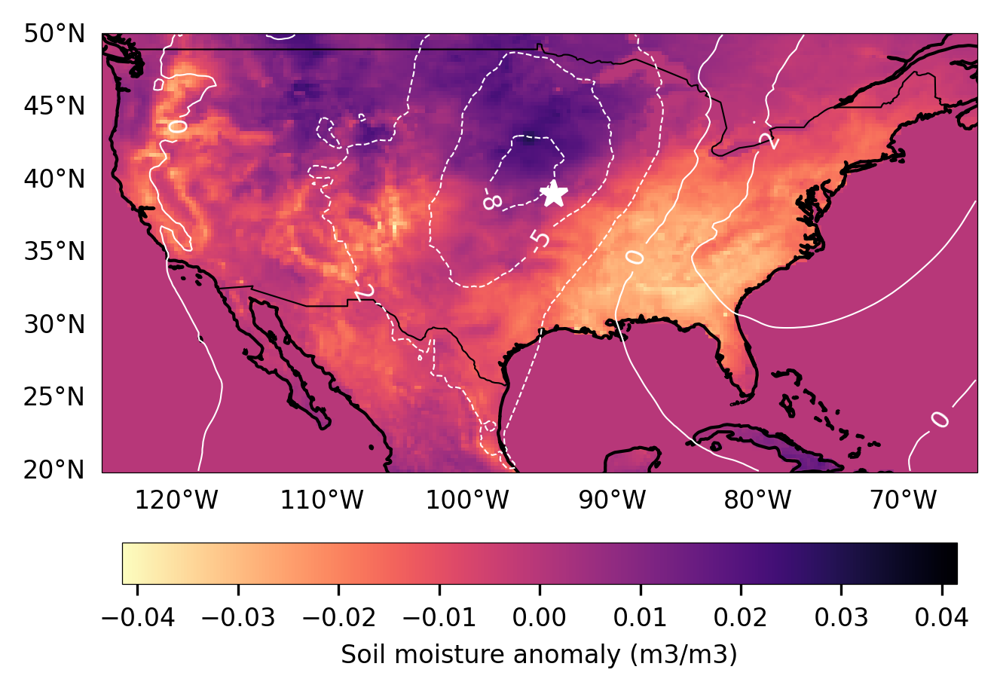

In [109]:
# Setup plot
fig, ax = plt.subplots(figsize=(5, 4), subplot_kw={'projection': ccrs.PlateCarree()})
ax.coastlines()
ax.add_feature(cfeature.BORDERS, linewidth=0.5)
#ax.add_feature(cfeature.RIVERS, linewidth=0.3)
#ax.add_feature(cfeature.STATES, edgecolor='black', zorder=10)

gls = ax.gridlines(draw_labels=True, color='none')
gls.top_labels = False
gls.right_labels = False

current_plot = [soilm_an.plot(cmap=magma_cmap,
    transform=ccrs.PlateCarree(), add_colorbar=True, 
    cbar_kwargs={'fraction': 0.06, 'orientation': 'horizontal', 'pad': 0.1, 
    'label': 'Soil moisture anomaly (m3/m3)'})]
line_c = ax.contour(ps_an.longitude, ps_an.latitude, ps_an, 
colors='white', transform=ccrs.PlateCarree(), levels=5, linewidths=0.5, vmin=900)
ax.clabel(
        line_c,  # Typically best results when labelling line contours.
        colors=['white'],
        manual=False,  # Automatic placement vs manual placement.
        inline=True,  # Cut the line where the label will be placed.
        fmt=' {:.0f} '.format,  # Labels as integers, with some extra space.
    )

ax.plot(lon_sel, lat_sel, transform=ccrs.PlateCarree(),
            marker='*', color='white', markersize=9, linestyle='')

In [ ]:
# Setup plot
fig, ax = plt.subplots(figsize=(5, 4), subplot_kw={'projection': ccrs.PlateCarree()})
ax.coastlines()
ax.add_feature(cfeature.STATES, edgecolor='black', linestyle=':')

gls = ax.gridlines(draw_labels=True, color='none')
gls.top_labels = False
gls.right_labels = False

plt.title('Anomaly when Texas has an AR, year=2023')

lhf_an.plot(cmap=magma_cmap,
    transform=ccrs.PlateCarree(), add_colorbar=True, 
    cbar_kwargs={'fraction': 0.05, 'orientation': 'horizontal', 'pad': 0.1, 
    'label': 'Latent heat flux anomaly (W/m2)'}, vmin=0)

ax.plot(lon_sel, lat_sel, transform=ccrs.PlateCarree(),
            marker='*', color='white', markersize=9, linestyle='')
plt.show()

In [ ]:
# Setup plot
fig, ax = plt.subplots(figsize=(5, 4), subplot_kw={'projection': ccrs.PlateCarree()})
ax.coastlines()
ax.add_feature(cfeature.STATES, edgecolor='black', linestyle=':')

gls = ax.gridlines(draw_labels=True, color='none')
gls.top_labels = False
gls.right_labels = False

ax.set_title('Anomaly when Texas has an AR, year=2023')

mtpr_an.plot(cmap=magma_cmap,
    transform=ccrs.PlateCarree(), add_colorbar=True, 
    cbar_kwargs={'fraction': 0.05, 'orientation': 'horizontal', 'pad': 0.1, 
    'label': 'Precipitation anomaly (mm/day)'}, vmin=0)

ax.plot(lon_sel, lat_sel, transform=ccrs.PlateCarree(),
            marker='*', color='white', markersize=9, linestyle='')
plt.show()